# *Main Research Question*

How do product, customer, and transactional characteristics interact to influence the overall profitability and sales performance of the business operations?


To address this research question, the analysis examines how product characteristics and transactional patterns influence profitability and sales performance. Using a combination of clustering techniques and descriptive analytics, products are segmented based on shared financial and behavioral profiles, allowing us to identify profit-driving segments, loss-making groups, and underlying patterns such as seasonality, stability, and category-specific dynamics. These results provide a structured and data-driven understanding of the key factors shaping business performance and support informed decision-making for assortment, pricing, and operational improvements.

Note: During the development of the analytical workflow, AI-based tools (ChatGPT) were used to refine code structure, enhance clarity, and validate methodological choices. The analytical logic, interpretation, and implementation remain researcher-driven; AI assistance served only as a supportive tool, not as a source of copied content.

# Research Overview

Research Sub-Question: Do sales channels and invoice activity significantly influence the average profitability per transaction, after controlling for price and transaction volume?

The analysis presented below investigaes whether the sales channel and volume of invoices associated with transactions affect overall profitability when other factors (namely price and transaction volume) are held constant.

Hypothesis:
H0: After controlling for total cost and revenue, there is no significant difference in average profitability accross sales channels.

H1: After controlling for total cost and revenue, sales channels and invoice patterns significantly differ in their impact on average profitability per transaction.

Structure of this Notebook:
1. Data Preparation and Feature Selection
2. Exploratory Analysis
3. Preprocessing and Scaling
4. KMeans Clustering Analysis
5. Channel Composition and Visualization
6. Statistical Tests (ANOVA and Kruskal-Wallis)
7. Regression Analysis (OLS)
8. Predicted Profit Margins (Adjusted Estimates)

All markdown explanations are placed directly below the cell they reference.

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.ticker as mtick
import matplotlib.animation as animation
from matplotlib.animation import PillowWriter
import seaborn as sns
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.cluster import KMeans, DBSCAN
from sklearn.linear_model import LinearRegression
from sklearn.metrics import silhouette_score
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.decomposition import PCA
from scipy import stats
from semopy import model
from statsmodels.stats.outliers_influence import variance_inflation_factor
from scipy.stats import kruskal
import statsmodels.formula.api as smf
import statsmodels.api as sm
from mpl_toolkits.mplot3d import Axes3D


df1 = pd.read_parquet(r"C:\Users\arian\OneDrive\Desktop\business statistics\post exam\statistics_group_project\TaoYin_Item_features - Copy.parquet")
df2 = pd.read_parquet(r"C:\Users\arian\OneDrive\Desktop\business statistics\post exam\TaoYin_User_Transactions_v2.parquet")

# First, the libraries and files used to perform analysis are defined.

In [2]:

# 1 Normalize names and keys
df1.columns = df1.columns.str.strip().str.lower()
df2.columns = df2.columns.str.strip().str.lower()
df1['articlenr'] = df1['articlenr'].astype(str).str.strip()
df2['articlenr'] = df2['articlenr'].astype(str).str.strip()

# 2 Identify active products (any EF* column not null)
ef_cols = [c for c in df1.columns if c.startswith('ef')]
active_mask = df1[ef_cols].notna().any(axis=1)
active_df = df1.loc[active_mask].copy()  # keep ALL columns
print(f"Feature_Available items before merge: {len(active_df):,}")

#3 Aggregate df2 (transactions) by articlenr
# include the most frequent channel per product

#function provided by Jun
def mode_or_first(s):
    m = s.mode()
    return m.iloc[0] if not m.empty else np.nan
tx_agg = (
    df2.groupby('articlenr', as_index=False)
       .agg(
           tx_sum1=('sum1', 'sum'),
           tx_sum2=('sum2', 'sum'),
           tx_volume=('volume', 'sum'),
           invoice_count=('invoice', 'nunique'),
           invoice_first=('invoice', 'first'),
           channel=('channel', mode_or_first)
       )
)

# 4 Merge (inner -> only active products that sold)
active_with_sales = active_df.merge(tx_agg, on='articlenr', how='inner')

# 5 Add derived metrics
active_with_sales['price'] = np.where(
    active_with_sales['tx_volume'] > 0,
    active_with_sales['tx_sum1'] / active_with_sales['tx_volume'],
    np.nan
)
active_with_sales['profit'] = active_with_sales['tx_sum1'] - active_with_sales['tx_sum2']
print(f"Feature_Available items with sales (merged): {len(active_with_sales):,}")
print("Columns in merged df:", active_with_sales.columns.tolist())

active_with_sales['channel_group'] = active_with_sales['channel'].str.extract(r'^(\w+)')

Feature_Available items before merge: 167,261
Feature_Available items with sales (merged): 8,031
Columns in merged df: ['articlenr', 'ef000001', 'ef000002', 'ef000003', 'ef000004', 'ef000005', 'ef000006', 'ef000007', 'ef000008', 'ef000010', 'ef000012', 'ef000013', 'ef000014', 'ef000015', 'ef000016', 'ef000017', 'ef000018', 'ef000019', 'ef000022', 'ef000024', 'ef000025', 'ef000026', 'ef000029', 'ef000030', 'ef000033', 'ef000034', 'ef000035', 'ef000036', 'ef000037', 'ef000038', 'ef000039', 'ef000040', 'ef000041', 'ef000042', 'ef000046', 'ef000048', 'ef000049', 'ef000051', 'ef000054', 'ef000055', 'ef000057', 'ef000060', 'ef000061', 'ef000062', 'ef000063', 'ef000064', 'ef000065', 'ef000067', 'ef000070', 'ef000071', 'ef000072', 'ef000073', 'ef000074', 'ef000076', 'ef000078', 'ef000079', 'ef000080', 'ef000081', 'ef000083', 'ef000084', 'ef000085', 'ef000088', 'ef000089', 'ef000093', 'ef000097', 'ef000098', 'ef000101', 'ef000103', 'ef000104', 'ef000105', 'ef000106', 'ef000107', 'ef000109', 'ef

# Data preperation and feature engineering

the above code block performs the full preprocessing workflow required to prepare item-level sales data for analysis.

1. normalizing column names
- both datasets were cleaned to ensure consistant lowercase column names and to remove whitespace.
- prodyct identifiers (articlenr) were converted to strings and stripped, so they could be merged together

2. filtering available features
- df1 was filtered to only keep at least 1 non-missing EF value. these represent 'available' features and were kept for analysis. unavailable features were dropped.

3. transaction aggregation
- the sales transactions (df2) were grouped by articlenr so we could see the aggregated feature-level statistics.
ex:
- total revenue (tx_sum1)
- total cost (tx_sum2)
- total sales volume (tx_volume)
- number of unique invoices (invoice_count)
- sales channels (channel)

this step condensed transaction records into one summarized row per feature.

4. merge available features with aggregated results
- an inner join between 'active_df' (the available features) and 'tx_agg' (aggregated transactions) ensuring only available features with sales data were kept in the new, merged dataset  (active_with_sales)
the print statement confirmed the number of features remaining after filtering.

5. derive financial metrics
- price: the avergae price per unit (revenue / volume). used np.where to handle zero-volume cases
- profit: the difference between total revenue and total cost (tx_sum1 - tx_sum2)

these derived features are used later for profitability and clustering analysis.


interpretation:
- active_with_sales is a clean dataset containing only available, sold features.
- this code block ensured all analysis perfromed below are done on consistant, aggregated, financially meaningful data only.

In [3]:
# Drop duplicate articlenr rows, keeping the first occurrence
active_with_sales = active_with_sales.drop_duplicates(subset='articlenr', keep='first').reset_index(drop=True)

print(f"Remaining rows after dropping duplicates: {len(active_with_sales)}")
print(f"Unique articlenr values: {active_with_sales['articlenr'].nunique()}")


Remaining rows after dropping duplicates: 7840
Unique articlenr values: 7840


# Above, duplicate articlenr's were removed, keeping the first occurance only.

this is done to ensure articlenr (which is a unique identifier) is only listed once - preventing redundancy in the following analyses.

interpretation:
- 7,840 rows are unique feature entries; since both of the outputs match (remaining rows after dropping duplicates and unique articlenr values) I can conclude the duplacate removal was successful.

In [4]:
# Compute profit margin as % of total revenue (tx_sum2 = sales revenue)
#create a new column called profit_margin_pct
active_with_sales['profit_margin_pct'] = np.where(
    #if tx_sum2 is not 0, calculate the margin - as we cannot divide by 0
    active_with_sales['tx_sum2'] != 0,
    # profit_margin = (profit/sales) * 100
    100 * active_with_sales['profit'] / active_with_sales['tx_sum2'],
    #if sales are 0, return NaN
    np.nan
)

# A new column "profit_margin_pct" is created to visualize profit margin % compared to profit

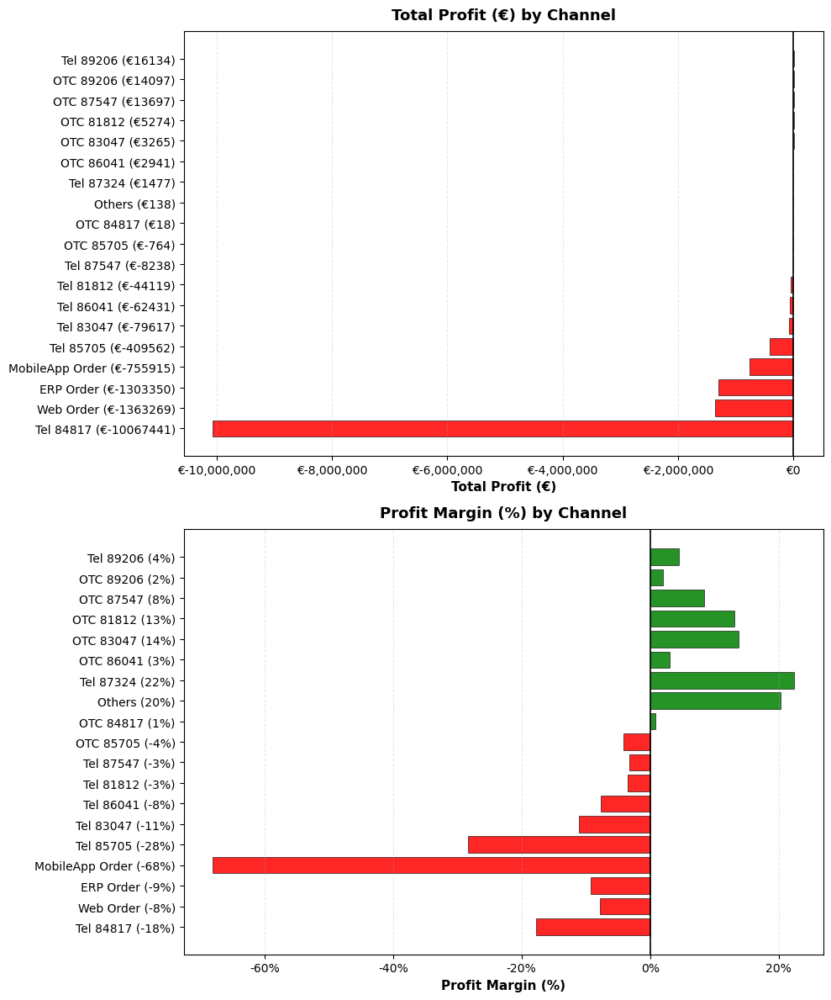

In [ ]:
#1) Aggregate by each individual channel
grouped = (
    active_with_sales
    #group by channel, and keep result as a column not an index
    .groupby('channel', as_index=False)
    #for each channel, compute total_profit and total_sales
    .agg(
        total_profit=('profit', 'sum'),
        total_sales=('tx_sum2', 'sum')   # use your revenue column
    )
)

# 2) Calculate profit margin (%) correctly
grouped['profit_margin_pct'] = np.where(
    # check total sales isnt 0
    grouped['total_sales'] != 0,
    #use absolute value of sales to avoid flipping sign when sales is negative
    grouped['total_profit'] / grouped['total_sales'].abs() * 100,
    np.nan
)

# 3 Sort (worst to best) so both plots line up
# negative profit at the top, positive at the bottom
grouped = grouped.sort_values('total_profit')

# 4 Labels for axes
grouped['profit_label'] = grouped['channel'] + ' (€' + grouped['total_profit'].round(0).astype(int).astype(str) + ')'
grouped['margin_label'] = grouped['channel'] + ' (' + grouped['profit_margin_pct'].round(0).astype(int).astype(str) + '%)'

# 5 Create stacked vertical plots - 1 figure with 2 stacked subplots
#fig size makes the images large enough so both charts are readable
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(10, 12))

# TOP: Total Profit (euro's)
# choose bar color based on profit sign (positive or negative)
colors_profit = ['red' if x < 0 else 'green' for x in grouped['total_profit']]
#draw the horizontal bar chart (barh)
ax1.barh(grouped['profit_label'], grouped['total_profit'],
         color=colors_profit, alpha=0.85, edgecolor='black', linewidth=0.5)
#add plot title and label x axis
ax1.set_title('Total Profit (€) by Channel', fontsize=13, fontweight='bold', pad=10)
ax1.set_xlabel('Total Profit (€)', fontsize=11, fontweight='bold')
#format x-axis ticks as euros with no decimals
ax1.xaxis.set_major_formatter(mtick.FuncFormatter(lambda x, _: f'€{x:,.0f}'))
#mark the 0 profit threshold
ax1.axvline(0, color='black', linewidth=1.2)
# add gridlines for easy visual
ax1.grid(axis='x', alpha=0.3, linestyle='--')

# BOTTOM: Profit Margin (%)
# choose bar color based on profit sign (positive or negative)
colors_margin = ['red' if x < 0 else 'green' for x in grouped['profit_margin_pct']]
#draw the horizontal bar chart (barh)
ax2.barh(grouped['margin_label'], grouped['profit_margin_pct'],
         color=colors_margin, alpha=0.85, edgecolor='black', linewidth=0.5)
#add plot title and label x axis
ax2.set_title('Profit Margin (%) by Channel', fontsize=13, fontweight='bold', pad=10)
ax2.set_xlabel('Profit Margin (%)', fontsize=11, fontweight='bold')
#format x-axis ticks as euros with no decimals
ax2.xaxis.set_major_formatter(mtick.FuncFormatter(lambda x, _: f'{x:.0f}%'))
#mark the 0 profit threshold
ax2.axvline(0, color='black', linewidth=1.2)
# add gridlines for easy visual
ax2.grid(axis='x', alpha=0.3, linestyle='--')

fig.tight_layout()
plt.show()


# The above code and visualizations compare total profit and profit margin % across all sales channels.

graph 1: total profit by channel

This bar graph shows the total profit generated by each channel

Insights:
- Tel 81847 has the largest loss, over 10 million euros
- Many other Tel, Web, ERP, and MobileApp channels also show significant losses
- A small amount of OTC channels and Tel channels generate very little positive profit.


graph 2: profit margin % by channel
This bar chart shows the profit margin for each channel

Insights:
- Several OTC channels have positive margins, ranging from 2% - 22%
- Many Tel, ERP, Web, and MobileApp channels show negative margins, between -3% and -68%
- MobileApp Order show the worst margin (-68%), followed by Tel 84817 at -18% and ERP order at -9%

Interpretation:
- An interesting conclusion can be made from the above visuals. MobileApp order, which loses money on a small amount of sales, shows a huge negative percentage in the 2nd graph.
- This is due to a small negative profit, divided by a small amoutn of sales - creating a large negative percentage.

MobileApp Order loses a small amount of money overall, but because its sales volume is so small, that loss becomes a huge negative profit margin.

Tel channel sales are both high volume and high loss. The company should prioritize fixing Tel channel due to its high euro losses, specifically Tel84817.

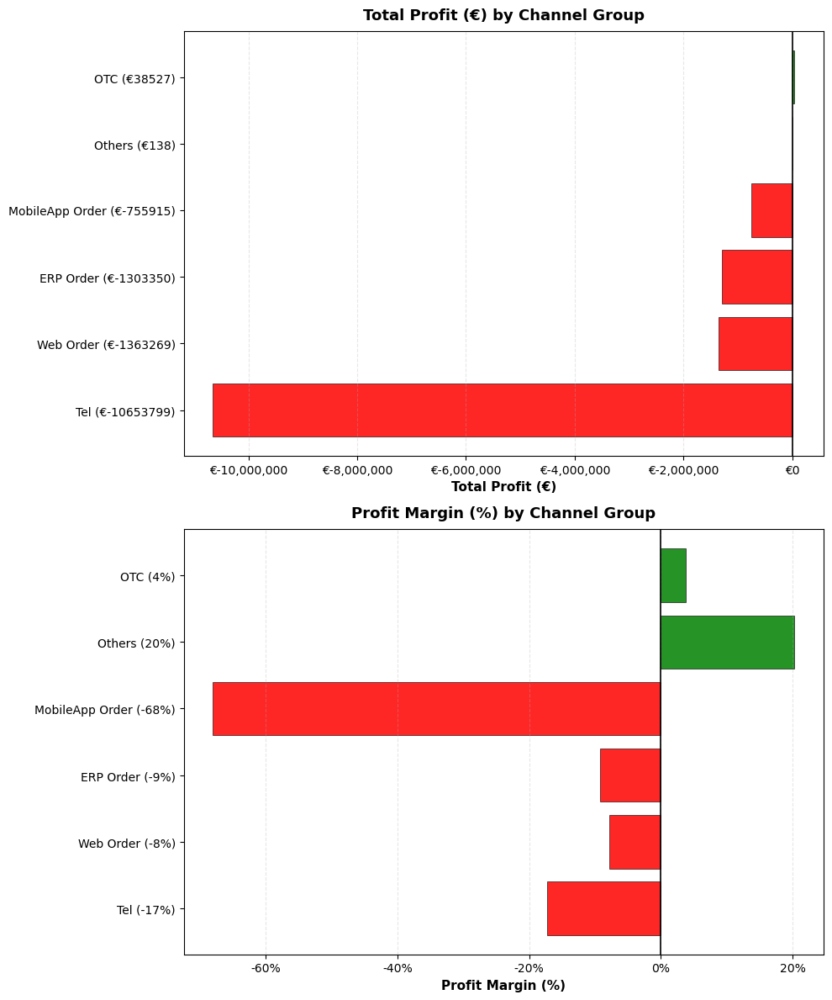

In [6]:
#the following code replicates that above, but uses grouped channels.

# 1) Create channel groups: "tel84817" -> "tel"
active_with_sales['channel_group'] = (
    active_with_sales['channel'].astype(str)
    .str.replace(r'\d+', '', regex=True).str.strip()
)

# 2) Aggregate to channel_group using revenue column tx_sum2
grouped_grp = (
        #take my dataframe, and group by channel_group
    active_with_sales
    .groupby('channel_group', as_index=False)
        #sum profit as total_profit, and tx_sum2 as total_sales
    .agg(
        total_profit=('profit', 'sum'),
        total_sales=('tx_sum2', 'sum')    # <-- use revenue here
)
    )

# 3) Calculate profit margin (%) from group totals (use abs on sales)
grouped_grp['profit_margin_pct'] = np.where(
    grouped_grp['total_sales'] != 0,
    grouped_grp['total_profit'] / grouped_grp['total_sales'].abs() * 100,
    np.nan
)

# 4) Sort and build labels
grouped_grp = grouped_grp.sort_values('total_profit')
grouped_grp['profit_label'] = grouped_grp['channel_group'] + ' (€' + grouped_grp['total_profit'].round(0).astype(int).astype(str) + ')'
grouped_grp['margin_label'] = grouped_grp['channel_group'] + ' (' + grouped_grp['profit_margin_pct'].round(0).astype(int).astype(str) + '%)'

# 5) Plot (stacked vertically, same style as above)
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(10, 12))

# Profit in euros
colors_profit = ['red' if x < 0 else 'green' for x in grouped_grp['total_profit']]
ax1.barh(grouped_grp['profit_label'], grouped_grp['total_profit'],
         color=colors_profit, alpha=0.85, edgecolor='black', linewidth=0.5)
ax1.set_title('Total Profit (€) by Channel Group', fontsize=13, fontweight='bold', pad=10)
ax1.set_xlabel('Total Profit (€)', fontsize=11, fontweight='bold')
ax1.xaxis.set_major_formatter(mtick.FuncFormatter(lambda x, _: f'€{x:,.0f}'))
ax1.axvline(0, color='black', linewidth=1.2)
ax1.grid(axis='x', alpha=0.3, linestyle='--')

# Profit Margin %
colors_margin = ['red' if x < 0 else 'green' for x in grouped_grp['profit_margin_pct']]
ax2.barh(grouped_grp['margin_label'], grouped_grp['profit_margin_pct'],
         color=colors_margin, alpha=0.85, edgecolor='black', linewidth=0.5)
ax2.set_title('Profit Margin (%) by Channel Group', fontsize=13, fontweight='bold', pad=10)
ax2.set_xlabel('Profit Margin (%)', fontsize=11, fontweight='bold')
ax2.xaxis.set_major_formatter(mtick.FuncFormatter(lambda x, _: f'{x:.0f}%'))
ax2.axvline(0, color='black', linewidth=1.2)
ax2.grid(axis='x', alpha=0.3, linestyle='--')

fig.tight_layout()
plt.show()


# The above code replicates the previous code block, but groups by channel to provide a higher-level overview of profitability patterns across the organizations sales routes.

Graph 1: Total profit by channel group
This visual shows Tel channel as the largest loss-making group by far - at roughly -10.6 million euros
- Web Order, ERP order, and MobileApp order are also loss making, but at much smaller scales.
- OTC is the strongest group, yet it only generates roughly 360k in profit.
- The 'Others' channel is almost breaking even, with neglibale profit (138 euros)

Graph 2: Profit margin by channel group
This visual shows 'others' as the highest profit margin
- OTC maintains a very low profit margin (4%)
- MobileApp order has an extremely negative margin (-68%) due to relatively low sales volume combined with sizeable losses.
- Tel channel does not show the worst profit margins, but the absolute scale of loss dominates the comapny's total profit

Interpretation / comparison with the previous results:
In the ungrouped visuals, multiple Tel channels were spread accross the chart/ When grouped, their combined loss becomes extremely apparent.

In the ungrouped visuals, MobileApp Order channels showed high negative margins; when grouped, their margins continue to show this inefficiency. However total loss remains modest when compared to Tel channel.

In the ungrouped visuals, OTC channels were scatters; grouping shows consolidated profit at 380k with a positive margin.

With grouping applied, the patterns becomes clear.
- Individual small channels no longer dominate the visuals; grouped data highlights structural trends, and exposes which channels are fundementally profitable or unprofitable.

Overall, Tel channel is a major financial risk: losses are large enough to define overall company perfoemance. Web, ERP, and MobileApp channels while structurally unprofitable, are not catastrophic individually.
OTC is the healthiest and most profitable group, although not enough to outweigh the above.

In [7]:
# 1️ Compute derived variables

# Average profit per transaction
#create a new column to my df, and use np.where to avoid dividing by 0
active_with_sales['avg_profit_per_tx'] = np.where(
    active_with_sales['tx_volume'] > 0,
    #compute average profit per transaction
    # avg profit per transaction = total profit / # of transactions
    active_with_sales['profit'] / active_with_sales['tx_volume'],
    #if not transactions, state NaN
    np.nan
)

# Log-transform invoice_count to reduce skew
#create a new column in my df: invoice_count_log
#use log1p to handle 0's safely -> compresses large numbers while preserving relative order
active_with_sales['invoice_count_log'] = np.log1p(active_with_sales['invoice_count'])

# 2️ Select features for VIF check
num_features = ['profit_margin_pct', 'avg_profit_per_tx', 'price', 'invoice_count_log']

#use only my 4 features, remove NaN rows, and create a copy to not change the original df
X = active_with_sales[num_features].dropna().copy()

# 3️ Add constant (required for VIF computation)
X_const = sm.add_constant(X)

# 4️ Compute VIF values
#create VIF df
vif_data = pd.DataFrame()
#store variable names
vif_data['Variable'] = X_const.columns
#loop through each column index, and for each variable, compute VIF, and store values in a 2nd column
vif_data['VIF'] = [variance_inflation_factor(X_const.values, i) for i in range(X_const.shape[1])]

print(vif_data)

            Variable       VIF
0              const  3.358978
1  profit_margin_pct  1.209428
2  avg_profit_per_tx  1.215049
3              price  1.033305
4  invoice_count_log  1.026850


# The Variance Inflation Factor (VIF) test was performed on 4 chosen features to check for multicolinierity.

VIF: measures how much the variance of a regression coefficient is inflated due to correlations among predictors. High VIF values (above 5-10) indicate multicollinierity, which can distort model estimates.

step 1: compute derived variables
- avg_profit_per_tx: the profit earned per transaction
- invoice_count: was log-transformed (invoice_log_count) to reduce right skewness and improve normality

step 2: select features
- The chosen features are: profit_margin_pct, avg_profit_per_tx, price, and invoice_count_log

step 3: computation
- a constant was added (this is a requirement of VIF)
- each variables' VIF was calculated through: statsmodels.stats.outliers_influence import variance_inflation_factor

interpretation:
- all VIF's were below 2 -> no significant multicollinierity among chosen predictors

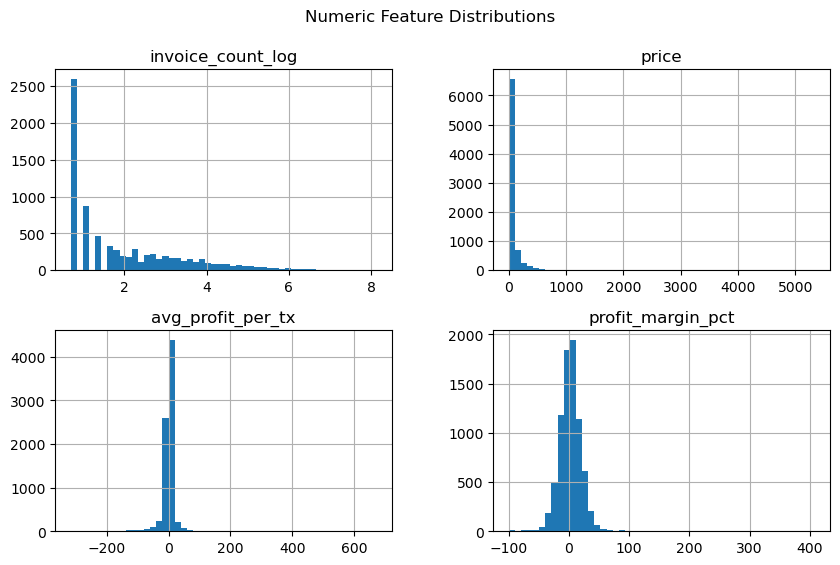

In [8]:
#define the numeric features i want to visualize
NUM_FEATS = ['invoice_count_log','price','avg_profit_per_tx','profit_margin_pct']
#plot the 4 variables
active_with_sales[NUM_FEATS].hist(bins=50, figsize=(10,6))
#add titles
plt.suptitle("Numeric Feature Distributions")
plt.show()

# The visualizations here show the distribution of the 4 features used for clustering.
- The histograms show data skewness, scale differences, and potential outliers - all of which need to be taken into consideration before clustering.

interpretation:
- invoice_count_log: distribution is slightly right-skewed, even after log transformation. Most observations cluster toward lower transaction counts -> suggets many channels issue few invoices compared to a small amount of highly active ones

- price: heavy right tail indicating a few very high-priced transactions; most transactions occur at lower price levels

- avg_profit_per_tx: centered around 0 with some spread on either side -> most transactions yield modest profits, with few generating significantly higher/lower returns

- profit_margin_pct: approximately normally distributed with a slight negative skew -> most transactions have moderate profitability, with a few cases of extreme high/low margins


In [9]:
# 1 My 5 features (4 numeric + 1 categorical
NUM_FEATS = ['invoice_count_log', 'price', 'avg_profit_per_tx', 'profit_margin_pct']  # numeric
CAT_FEATS = ['channel_group'] # categorical (one-hot)
FEATS = NUM_FEATS + CAT_FEATS

# 2 Basic cleaning for selected features
X = active_with_sales[FEATS].copy()
# numeric: fill NaN with 0
X[NUM_FEATS] = X[NUM_FEATS].fillna(0)
# categorical: fill NaN with 'Unknown'
for c in CAT_FEATS:
    X[c] = X[c].astype(str).fillna('Unknown')

# 3 Preprocess: scale numerics + one-hot encode categoricals
#columnTransformer: applies different transformation to different column types in 1 step
preprocess = ColumnTransformer(
    transformers=[
        #for all numeric features, apply StandardScalar
        ('num', StandardScaler(), NUM_FEATS),
        #for all catagorical features, apply One-Hot Encoding
        ('cat', OneHotEncoder(handle_unknown='ignore', sparse_output=False), CAT_FEATS),
    ],
    #keep only the columns specified - drop the rest
    remainder='drop'
)

# Prepare data for KMeans clustering

The above code selects 4 features which i will prepare for clustering.

step 1: feature selection:
- 4 independant variables were selected based on theoretical relevance to profitability and prior exploratory analysis:
    - 'invoice_count_log': captures transaction frequency per entity (log-transformed to reduce skew)
    - 'price': represents the average price per transaction, controlled for pricing effects
    - 'avg_profit_per_tx': measures absolute profitability per transaction
    - 'profit_margin_pct': shows relative profitability efficiency (% of revenue retained as profit)
    - channel_group: categorical feature distinguishing the sales channels

These variables align with the sub-research questions on whether sales channnels significantly influence average profitability per transaction, while controlling for cost/revenue-related factors

step 2: clean the data
- a subset of 'active_with_sales' df was copied and cleaned to ensure compatability with KMeans:
    - missing numerical values were filled with 0 to prevent errors
    - missing categorical values were replaced with 'unknown' to preserve the observation instead of dropping it

step 3: data preprocessing:
- StandardScalar normalized numeric features (mean = 0, STD = 1) to ensure they contributed equally to the clustering distance metric
- OneHotEncoding was performed on channel_group to allow KMeans to interpret the non-numeric data properly

All features are now on a comparable scale and encoded correctly for accurate clustering.

In [ ]:
# outlier detection

# 1: compute 25th and 75th percentiles
Q1 = active_with_sales[NUM_FEATS].quantile(0.25)
Q3 = active_with_sales[NUM_FEATS].quantile(0.75)
#compute InterQuartile Range
IQR = Q3 - Q1

#identify outliers using 1.5x IQR
outlier_mask = ((active_with_sales[NUM_FEATS] < (Q1 - 1.5 * IQR)) |
                #.any(axis=1): if any column in thi row is an outlier, mark the whole row as an outlier
                (active_with_sales[NUM_FEATS] > (Q3 + 1.5 * IQR))).any(axis=1)

#count the number of outliers vs the length of the df
print(f"Outliers detected: {outlier_mask.sum()} of {len(active_with_sales)} rows")


Outliers detected: 2210 of 7840 rows


# outlier detection

the IQR method was applied across the 4 continuous features to detect the presence of extreme outliers.

The lower and upper bounds were defined as Q1 - 1.5 * IQR and Q3 + 1.5 * IQR
- points outside this range were flagged.

interpretation:
- 2,210 out of 7,840 contained outlier valued in at least one numeric feature.
- given the business context, these observations are kept for further analysis in order to preserve the real-world variance in profitability/sales activity.

 invoice_count_log  min=0.693  max=8.143  neg=0  inf=0
             price  min=0.000  max=5339.400  neg=0  inf=0
 avg_profit_per_tx  min=-317.358  max=674.000  neg=3472  inf=0
 profit_margin_pct  min=-100.000  max=408.213  neg=3472  inf=0


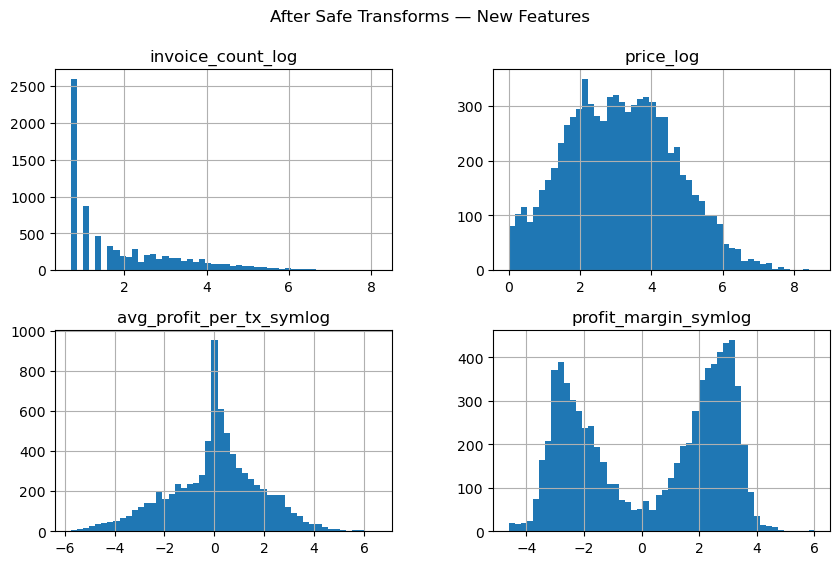

In [ ]:
# 1 Inspect the raw ranges
# for each column specified:
for c in ['invoice_count_log', 'price', 'avg_profit_per_tx', 'profit_margin_pct']:
    print(
        # print the minimum value (3 decimals)
        f"{c:>18}  min={np.nanmin(active_with_sales[c]):.3f}  "
        # print the maximum value (3 decimals)
        f"max={np.nanmax(active_with_sales[c]):.3f}  "
        # count negaitve values
        f"neg={np.isfinite(active_with_sales[c]).sum() - (active_with_sales[c] >= 0).sum()}  "
        # count infinite values
        f"inf={np.isinf(active_with_sales[c]).sum()}"
    )

# 2 feature transformation
#create log-transformed version of price (price_log)
# clip negative values to 0, and store result in new feature
active_with_sales['price_log'] = np.log1p(active_with_sales['price'].clip(lower=0))

#create symmetric log transform (symlog) for profit (contains pos and neg values)
active_with_sales['avg_profit_per_tx_symlog'] = (
    #take the sign of the original value (preserves direction)
    np.sign(active_with_sales['avg_profit_per_tx']) *
    #take absolute value and log-transform; multiply sign * transformed magnitude (transformation will be symmetric)
    np.log1p(np.abs(active_with_sales['avg_profit_per_tx']))
)

#because profit_margin_pct can be negative, I use symmetric log here as well
active_with_sales['profit_margin_symlog'] = (
    np.sign(active_with_sales['profit_margin_pct']) *
    np.log1p(np.abs(active_with_sales['profit_margin_pct']))
)

# 3 Plot the transformed versions
active_with_sales[
    ['invoice_count_log', 'price_log', 'avg_profit_per_tx_symlog', 'profit_margin_symlog']
].hist(bins=50, figsize=(10, 6))
plt.suptitle("After Safe Transforms — New Features")
plt.show()

# Here, safe logarithmic and symmetric transformations were performed to reduce skewness and improve the normailty of my nnumeric features before modelling.

Step 1: inspection
- each features' minimum/maximum value was checked, and any negative or infinite values were noted
    - invoice_log_count and price contained only non-negative values, while avg_profit_per_tx and profit_margin_pct had roughly 4,300 negative entries

Step 2: feature transformation
- price: transformed with np.log1p() to compress large values and reduce right skew
- avg_profit_per_tx and profit_margin_pct: transformed with a symmetric log (symlog) function to preserve sign information (allows positive and negative profit values to be scaled consistantly)

Step 3: visualization
- histograms were plotted for each transformed feature to verify distribution changes

interpretation:
- invoice_count_log: still right-skewed, but much less extreme
- price_log: shows a smoother normal distribution -> large transaction prices were compressed effectively

- average_profit_per_tx_symlog: roughly centered at 0 -> balanced positive/negative profit transactions after transformation

- profit_margin_symlog: a bimodal pattern emerged revealing 2 profitability regimes (profitable and unprofitable)

In [12]:
# Build and apply preprocessing pipeline (scaling + encoding)

# Define the transformed numeric + categorical features (again since they have been renamed)
NUM_FEATS = ['invoice_count_log', 'price_log', 'avg_profit_per_tx_symlog', 'profit_margin_symlog']
CAT_FEATS = ['channel_group']

# 1️ Define preprocessing steps
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), NUM_FEATS),
        ('cat', OneHotEncoder(drop='first', sparse_output=False), CAT_FEATS)
    ],
    remainder='drop'
)

# 2️ Apply the preprocessing pipeline
X_prep = preprocessor.fit_transform(active_with_sales)

# 3️ Retrieve the transformed feature names
encoded_cols = preprocessor.get_feature_names_out()

print("Final feature matrix shape:", X_prep.shape)
print("Transformed columns:", encoded_cols)

Final feature matrix shape: (7840, 9)
Transformed columns: ['num__invoice_count_log' 'num__price_log' 'num__avg_profit_per_tx_symlog'
 'num__profit_margin_symlog' 'cat__channel_group_MobileApp Order'
 'cat__channel_group_OTC' 'cat__channel_group_Others'
 'cat__channel_group_Tel' 'cat__channel_group_Web Order']


# This block creates and applies the final preprocessing pipeline to prepare all features for cluserting.

The columnTransformer applies both transformations simultaneously, outputting a fully processed feature matrix (x_prep)
- this is a numeric matrix suitable for ML algorithms that require standardized, non-input text

interpretation:
- the final matrix shape depends on the number of records and encoded columns
- the transformed column names are printed allowing for verification

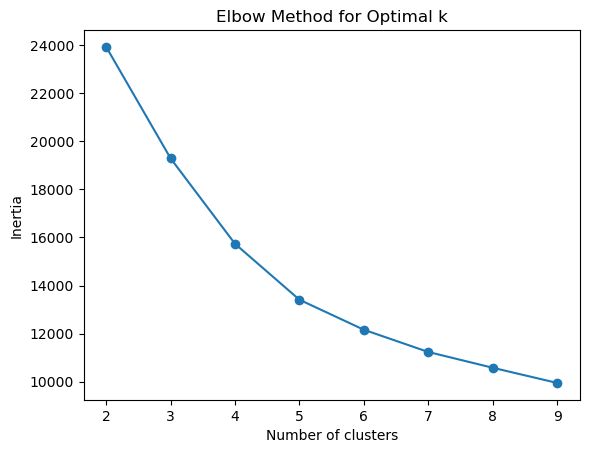

In [13]:
inertias = []
for k in range(2, 10):
    km = KMeans(n_clusters=k, random_state=42).fit(X_prep)
    inertias.append(km.inertia_)

plt.plot(range(2,10), inertias, marker='o')
plt.title('Elbow Method for Optimal k')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')
plt.show()

# Apply Elbow Method
The elbow method is applied to determine the number of clusters (k) that should be used on the preprocessed features (x_prep),

The elbow method: evaluates how the total within-cluster variation decreases as the number of clusters increases

interpretation:
- steep drop between 2 and 4, followed by a more gradual decline after
    - diminishing returns after k = 4

In [14]:
# 1) Run KMeans with k = 4 (based on Elbow Method)
kmeans = KMeans(n_clusters=4, random_state=42)
active_with_sales['cluster_k4'] = kmeans.fit_predict(X_prep)

# 2) Summarize cluster characteristics
cluster_summary = (
    active_with_sales.groupby('cluster_k4')
    [['invoice_count_log', 'price_log', 'avg_profit_per_tx_symlog', 'profit_margin_symlog']]
    .mean()
    .round(2)
)

print("Cluster Summary (mean values per feature):")
print(cluster_summary)


Cluster Summary (mean values per feature):
            invoice_count_log  price_log  avg_profit_per_tx_symlog  \
cluster_k4                                                           
0                        1.54       3.91                     -2.12   
1                        1.39       4.40                      2.27   
2                        4.26       2.47                     -0.39   
3                        1.51       1.81                      0.37   

            profit_margin_symlog  
cluster_k4                        
0                          -2.52  
1                           2.58  
2                          -0.75  
3                           1.57  


# I have now applied the KMeans clustering on the optimal number of clusters (k=4) determined in the elbow method.

interpretation:
- cluster 0: high price and high profit cluster - strong profitability and moderate invoice volume
- cluster 1: high price but low margin cluster - possible inefficiency or high operational cost
- cluster 2: high invoice activity but moderate profitability - most likely driven by transaction volume
- cluster 3: low price and low profit cluster - potentially less valueable customer/channel

In [15]:
#create a contingency table
pd.crosstab(active_with_sales['cluster_k4'], active_with_sales['channel_group'], normalize='index') * 100

channel_group,ERP Order,MobileApp Order,OTC,Others,Tel,Web Order
cluster_k4,,,,,,
0,30.850553,0.048054,2.787122,0.000000,44.882268,21.432004
1,11.864407,0.000000,9.296353,0.000000,50.282486,28.556754
2,35.364146,0.840336,5.392157,0.000000,12.464986,45.938375
3,16.526846,0.083893,11.954698,0.041946,41.526846,29.865772


# Cross-Tabulation
cross-tabulation analysis was performed on the 4 clusters and the categorical variable (channel_group) to see how each channel contributed to specific clusters

interpretation:
- cluster 0: dominated by Tel and ERP orders
- cluster 1: highest share of Tel and Web Orders
- cluster 2: strongly represented by Web Orders and ERP orders
- cluster 3: balanced mix between Tel and Web orders

Sales channels are not evenly distributed across clusters:
- Tel orders appear in many clusters -> they contribute to both high and low profitability segments
- ERP orders are present in high-volume business clients
- Web Orders dominate clusters with lower-cost sales

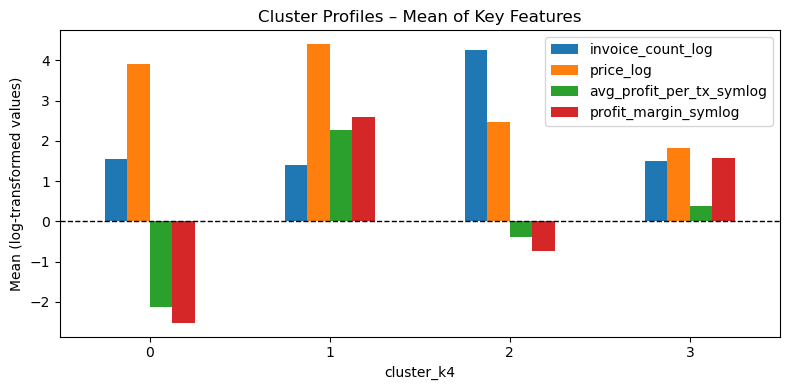

In [16]:
#plot the mean of each feature for each cluster to compare charactersitcis
cluster_summary.plot(kind='bar', figsize=(8,4))
plt.axhline(0, color='black', linewidth=1, linestyle='--')  # adds reference line
plt.title('Cluster Profiles – Mean of Key Features')
plt.ylabel('Mean (log-transformed values)')
plt.xlabel('cluster_k4')
#rotate X-axis ticks to 0 degrees (horizontal)
plt.xticks(rotation=0)
#ensure nothing is cut off
plt.tight_layout()
plt.show()

# cluster profiles

this visualization shows the mean log-transformed values for the 4 selected features across the 4-KMeans clusters.

the bar chart highlights the specific behaviour profile of each cluster. The zero baseline helps visually see the difference between profitable and unprofitable cluster characteristics, reinforcing the segmentation patterns identified through KMeans clustering

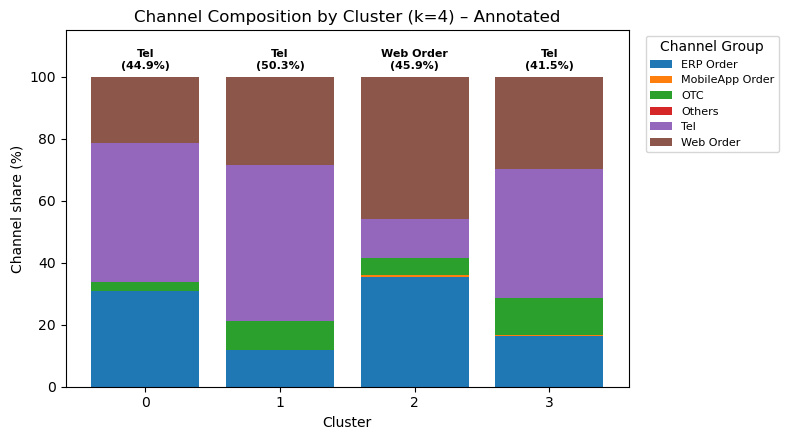

In [17]:
#see what percentage of each cluster belongs to each channel group
# create crosstab
ct = pd.crosstab(
    active_with_sales['cluster_k4'],
    active_with_sales['channel_group'],
    #convert each row to percentages
    normalize='index'
) * 100

# Compute dominant channel per cluster
dominant_channels = ct.idxmax(axis=1)
# get the percentage value of that dominance
dominant_values = ct.max(axis=1)

# Create Stacked bar chart
fig, ax = plt.subplots(figsize=(8, 4.5))
bottom = np.zeros(len(ct))

#loop over each channel group
for col in ct.columns:
    #create stacked bar for each segment in that channel, and update the 'bottom' of the stack
    ax.bar(ct.index, ct[col], bottom=bottom, label=col)
    bottom += ct[col].values

# Annotate each cluster with its dominant channel
#loop through each cluster index, pairing each channel with its matching value
for i, (chan, val) in enumerate(zip(dominant_channels, dominant_values)):
    #draw on the plot slightly above the bar - format as a percentage with 1 decimal
    ax.text(
        i, 102,  # just above 100%
        f"{chan}\n({val:.1f}%)",
        #styling
        ha='center', va='bottom', fontsize=8, fontweight='bold', color='black'
    )

# --- Formatting ---
ax.set_xlabel('Cluster')
ax.set_ylabel('Channel share (%)')
ax.set_title('Channel Composition by Cluster (k=4) – Annotated')
ax.legend(title='Channel Group', bbox_to_anchor=(1.02, 1), loc='upper left', fontsize=8)
plt.xticks(ct.index)
plt.ylim(0, 115)  # to make space for annotations
plt.tight_layout()
plt.show()

# Stacked bar chart
The stacked bar chart visualization shows the proportional composition of sales channels within each KMeans cluster, illustrating which sales channel dominates specific customer or transaction clusters to help identify overlap.

Each bar represents on cluster (0-3) and each color represents a different sales channel. The note on top of the bars detail the dominant channel and its share of the cluster.

Interpretation:
- cluster 0, Tel-44% : mostly made up of telephone orders, along with ERP and web transactions.
    - indicates a mix a human-assisted and structured B2B interactions
- cluster 1, Tel-50.5% : Also dominated by telephone orders
    - indicates this cluster represents traditional sales processes with strong human engagement
- cluster 2, web order-46.9% : strong association with digital transactions
    - indicates higher online activity and lower-cost order handling
- cluster 3, Tel-42.1% : Again driven by telephone orders, with a diverse mix of secondary channels (ERP and OTC)

Across all clusters, Tel orders dominate, emphasizing their central role in overall business activity.

Additionally, Web orders (which dominate cluster 2) highlights a growing digital segment within the transaction landscape

This visualization strengthens the analysis of sub-question 4 by showing that the sales channel composition varies across clusters -> influencing average profitability/operational characteristics across different transaction groups.

In [18]:
# --- K-Means clusters: animated 3D PCA (auto MP4/GIF) ---
# 1) Features I clustered on
features = ['profit_margin_pct', 'tx_sum2', 'tx_volume', 'price']

# create a subset of the df containing only the 4 features im clustering on
#fill missing values with 0 and convert the result into a numpy array
X = active_with_sales[features].fillna(0).to_numpy()

# 2) Scale -> PCA(3 components)
#this is done to plot a 3D scatterplot - so 3 components (PC1, PC2 and PC3 are plotted as axes)
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

#reduce my dataset to 3 principal components (the 4th is bubble size)
pca = PCA(n_components=3)
#fit: the directions of max variance in my data
#transform: project all my data on those 3 PCA axes
PC = pca.fit_transform(X_scaled)
#transpose: create 3 new columns in my df - each row getting a value that corresponds to that record (for plotting)
active_with_sales['PCA1'], active_with_sales['PCA2'], active_with_sales['PCA3'] = PC.T

# Clip to keep extreme outliers from flattening the cloud
#loop through each PCA column
for col in ['PCA1', 'PCA2', 'PCA3']:
    #calculate the 1st and 99th percentiles (bottom of distribution)
    #lo: value at the 1st percentile ; hi: value at 99th percentile (top of distribution)
    lo, hi = np.percentile(active_with_sales[col], [1, 99])
    #if value is less than 'lo': replace with lo
    #if value is greater than hi: replace with hi
    active_with_sales[col] = np.clip(active_with_sales[col], lo, hi)

# 3) Bubble size = revenue scale (abs in case of negatives)
#my 4th feature
#fill NaN with 0, take the absolute value (as bubbles cant be negative)
#convert to numpy array
rev = np.abs(active_with_sales['tx_sum2'].fillna(0).to_numpy())
#find max revenue, and divide every revenue by that maximum (gets a range)
#np.isfinite is a safety check to avoid dividing by 0
rev = rev / (rev.max() if np.isfinite(rev.max()) and rev.max() > 0 else 1.0)
#scale bubble size so its between 0 and 150 - and make 30 the minimum bubble size (so its large enough to see)
sizes = rev * 150 + 30

# 4) Build the static 3D figure first
# create a blank plotting canvas and choose the size (9.5 inches wide, 7.5 inches tall)
fig = plt.figure(figsize=(9.5, 7.5))
#add a 3D subplot to that figure
ax = fig.add_subplot(111, projection='3d')

# Put title and leave room so it doesn't get cut off
fig.suptitle('K-Means Clusters — 3D PCA (Animated)', fontsize=14, fontweight='bold', y=0.98)

# Consistent cluster colors
palette = ['blue', 'orange', 'green', 'red']
clusters = sorted(active_with_sales['cluster_k4'].unique())

#for each cluster and color, give me a pair (k for cluster number, color for th ecolor of the cluster)
for k, color in zip(clusters, palette):
    #boolean mask identifying which rows belong to which cluster (k)
    m = active_with_sales['cluster_k4'] == k
    #plot that cluster's points in 3D
    ax.scatter(
        active_with_sales.loc[m, 'PCA1'],
        active_with_sales.loc[m, 'PCA2'],
        active_with_sales.loc[m, 'PCA3'],
        #assign bubble size
        s=sizes[m],
        #color the cluster
        color=color, alpha=0.75,
        #style additions for each point
        edgecolor='black', linewidth=0.3,
        #add a legend label for the cluster
        label=f'Cluster {k}'
    )

# Axes labels with explained variance
#each PCA model contains the explained variance ration as an array
# print those percentages on the axes
ax.set_xlabel(f'PC1 ({pca.explained_variance_ratio_[0]*100:.1f}% Var)')
ax.set_ylabel(f'PC2 ({pca.explained_variance_ratio_[1]*100:.1f}% Var)')
ax.set_zlabel(f'PC3 ({pca.explained_variance_ratio_[2]*100:.1f}% Var)')

# create a Legend *outside* so it doesn’t overlap (prevents clipping)
#put the legend outside the plot
#bbox_to_anchor positions the legend to the right of the plot (102% tot he right of the axis), and 0.5 vertically centered
ax.legend(title='Cluster', bbox_to_anchor=(1.02, 0.5),
          #anchor the left side of the legend to the above position and remove any extra space between the plot edge and legend box
          loc='center left', borderaxespad=0.)

# Light grid + margins so nothing is cut off
ax.grid(alpha=0.3)
# Adjust margins: more right & top space for legend/title
fig.subplots_adjust(left=0.05, right=0.80, bottom=0.08, top=0.90)

# 5) Simple smooth rotation around the z-axis
def rotate(angle):
    # elev: elevation - the tilt od the angle - chose 20 degrees above horizontal plane to allow good visual
    #azim: azimuth - the left to right rotation around the plot
        #angle variable changes per frame im animating - rotating from 0 to 360 degrees (spinning animation)
    ax.view_init(elev=20, azim=angle)
    return fig,

#create an animation by repeadedly calling the rotate function
#fig: the figure object the animation draws on
# start at 0 degrees, end before 360 degrees, step by 2, interval of 80 milliseconds
ani = animation.FuncAnimation(fig, rotate, frames=range(0, 360, 2), interval=80)

# 6) Save animation as GIF using PillowWriter
#pillowWriter creates GIF files, set to 12 frames per second
writer = PillowWriter(fps=12)
#give the output a name
fname = '3D_KMeans_Clusters.gif'
# save it - dpi=150 for the resolution
ani.save(fname, writer=writer, dpi=150)
#close the figure
plt.close(fig)
#print if the animation was successful
print(f" Saved animation as {fname}")

 Saved animation as 3D_KMeans_Clusters.gif


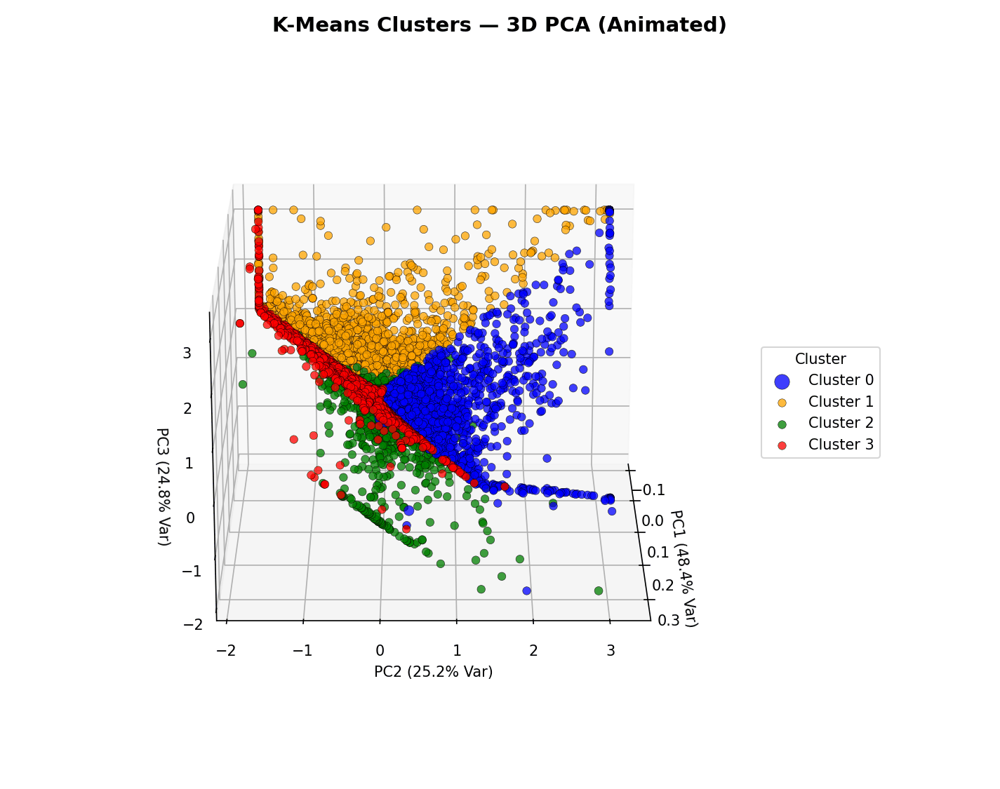

In [19]:
#import the image class to show images inside an output cell
from IPython.display import Image
#load and display GIF
Image(filename='3D_KMeans_Clusters.gif')

# The code and visual above show the KMeans Clusters - 3D PCA with animation

step 1: Select features used in clustering
- profit_margin_pct, tx_sum2(sales), tx_volume, and price

step 2: standardize all features with standard scalar (mean 0, STD 1) so no single scale dominates

step 3: reduce to 3 dimensions with PCA (PCA1 - PCA3) to visualize high-dimensional structure

4: Clip extreme PCA values at the 1st and 99th percentiles to prevent outliers from flattening the cloud

5: encode a 4th variable tx_sum2(sales) as bubble size
- larger bubble = higher revenue

6: color bubbles by cluster_k4

7: create a 3D scatter and animate a rotating view for depth perception

8: save animation as a GIF

Interpretation:
the axis (PC1, PC2, PC3) are linear combinations of the original variables capturing the most variance in the data
- labels show the percent of variance explained by each component

interpretation:
- The animation shows a dynamic view of the KMeans clustering results projected across the first 3 principal components. Together, these explain most of the variance in the standardized data.

Cluster positioning and structure:

cluster 0 (blue):
- Arranged as a plane tilted along PC2, spreading vertically through the cube.This cluster appears to represent transactions with higher sales volumes. The large blue outliers away from the main group indicates an exceptionally high-revenue observation - a one-time large order.

cluster 1 (orange):
- Positioned above and between the blue and red clusters, concentrated along the PC2 wall. Its vertical seperation and comact structure suggest high-margin, moderate-volume sales, representing efficient and profitable transactions. The fact it overlays multiple other clusters suggests it shares similarities with both high and low margin groups - but ahcieves better profitability efficiency overall.

cluster 2 (green):
- Occupies the center of the 3D space and extends upward towards the middle of the cube. It has the broadest spread implying heterogeneous mix of transactions with moderate - high variability in sales and margins. Its upward slant towards PC3 reflects interactions between price and profit margin, making it a transitional group that blens characteristics of the higher and lower performing clusters.

cluster 3 (red):
- forms a thin, linear band along the PC1 and PC2 plane, staying close to the floor and back wall of the cube. This implies strong linear relationships between its features. Its placement near the axes suggests this cluster represents low-variance behavior, possibly low-volume/low-profit orders that follow consistant pricing patterns.

This animation reveals that clusters form layyered planes rather than isolated spheres. This suggests the data relatioships are correlated. Below are the distinct transactional behaviors that can be seen in the visualization:
- cluster 0 (blue): high-sales but inconsistant profit
- cluster 1 (orange): smaller, efficient high-margin transactions
- Cluster 2 (green): diverse, mid-perfroming transactions
- Cluster 3 (red): stable, low-variance transactions


In [20]:
#one way ANOVA test
# Null Hypothesis: Sales channel significantly affects profitability
# Alternative Hypothesis: Fail to reject H₀: No significant difference between channels

# Group profit margin by channel
groups = [active_with_sales.loc[active_with_sales['channel_group'] == c, 'profit_margin_pct']
          for c in active_with_sales['channel_group'].unique()]

# One-way ANOVA
f_stat, p_val = stats.f_oneway(*groups)

print(f"F-statistic: {f_stat:.3f}, p-value: {p_val:.5f}")

if p_val < 0.05:
    print("Reject H₀: Sales channel significantly affects profitability.")
else:
    print("Fail to reject H₀: No significant difference between channels.")


F-statistic: 81.350, p-value: 0.00000
Reject H₀: Sales channel significantly affects profitability.


# One-way ANOVA was conducted to evaluate whether average profitability differs significantly between channels.

The dataset was divided into groups based on channel_group, and profit_margin_pct was compared across these groups.

interpretation:
- The F-statistic of 81.35 with a P-value of 0.00 indicate that the variation in average profit margin between groups is greater than the variation within groups
- A P-value of 0.00 means the probability of observing such large differences in average profitability by chance is virtually 0.
    - Therefore, the Null hypothesis - profitability is not equal across channels - is rejected.

We can conclude there is a statistically significant difference in mean profitability between the various sales channels.

In [21]:
# Kruskal-Wallis H test

groups = [active_with_sales.loc[active_with_sales['channel_group'] == c, 'profit_margin_pct']
          for c in active_with_sales['channel_group'].unique()]

h_stat, p_val = kruskal(*groups)

print(f"H-statistic: {h_stat:.3f}, p-value: {p_val:.5f}")

H-statistic: 552.536, p-value: 0.00000


# Kruskal-Wallis H Test
Because profit_margin_pct may not meet the normality assumption required for ANOVA, Kruskal-Wallis H test was conducted as a nonparametric alternative.

Kruskal-Wallis H test: evaluates whether the median profitability significatnyl differs between channels (without assuming normal distribution)

interpretation:
- The H-statistic of 552.54 with a P-value of 0.00 indicate that differences in median profit margin between sales channels are highly significant.
- A P-value of 0.00 means the probability of observing such large differences in median profitability by random variation is essentially 0.
    - therefore, the null hypothesis - median profitability is not equal across sales channels - is rejected.

We can conclude the sales channel choice has a meaningful impact on profit margins, reguardless of if the data is normally distributed.

We have now performed a parametric (ANOVA) and non-parametric (Kruskal-Wallis) test, both of which support the Alternative hypothesis that sales channels significantly influence average profitability per transaction.

# Now, Ordinary Least Squares (OLS) regression is performed to see how sales channel influences profitability while controlling for price and transaction volume.

The model is defined as:
profit margin % = B0 + B1(Price) + B2(Transaction Volume) + ∑ B3(Channel Volume) + error

In [22]:
#OLS Regression

df = (active_with_sales
      [['profit_margin_pct','price','tx_volume','channel_group']]
      .dropna())

formula = "profit_margin_pct ~ price + tx_volume + C(channel_group)"
ols = smf.ols(formula=formula, data=df).fit(cov_type='HC3')  # robust SEs
print(ols.summary())

                            OLS Regression Results                            
Dep. Variable:      profit_margin_pct   R-squared:                       0.049
Model:                            OLS   Adj. R-squared:                  0.049
Method:                 Least Squares   F-statistic:                     53.21
Date:                Fri, 14 Nov 2025   Prob (F-statistic):           1.24e-74
Time:                        12:58:02   Log-Likelihood:                -34187.
No. Observations:                7840   AIC:                         6.839e+04
Df Residuals:                    7832   BIC:                         6.845e+04
Df Model:                           7                                         
Covariance Type:                  HC3                                         
                                          coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------
In

# Results:
- R² = 0.053
- F-Statistics = 55.96 (P<0.001)
- Observations: 7,840
- Covariance type: HC3 (robust standard errors)

ERP orders serves as a baseline for comparison (reference category)

Tel, OTC, and Web Order channels show significant negative coefficients
- indicates lower profit margins than ERP orders

Price has a positive and significant effect on profitability

Transaction Volume does not significatnyl influence profit margin ( P=0.974)

Interpretation:
- ERP orders are the most profitabile baseline channel
- Telephone and web orders have lower average profit margins
- price is strongly correlated with higher margins, suggesting premium-priced items deliver higher profitability

the model explains roughly 5.3% of the variance
- this is typical for business datasets as many unobserved factors influence profitability as well.

C:\Users\arian\AppData\Local\Temp\ipykernel_26148\1918917933.py:25: UserWarning: 

The `join` parameter is deprecated and will be removed in v0.15.0. You can remove the line between points with `linestyle='none'`.

  sns.pointplot(data=coef_df, x='channel', y='coef', join=False,


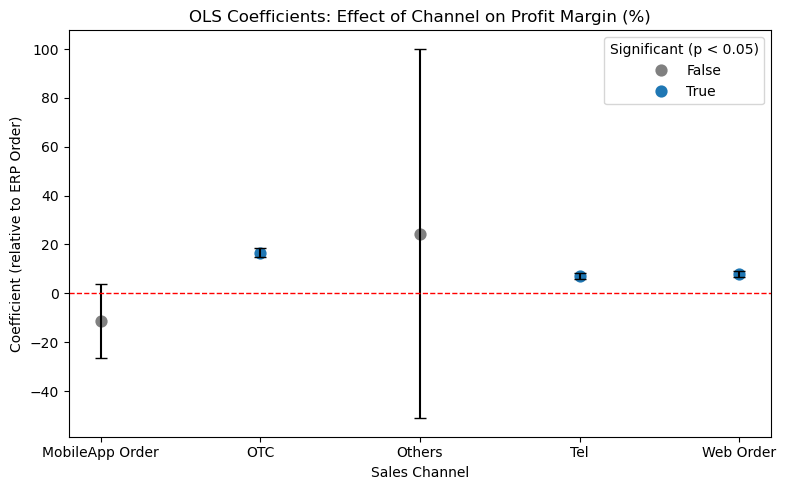

In [23]:
#visualize OLS Regression Results

# Extract channel coefficients (skip intercept and continuous vars)
# select only dummy variables for channel_group
coef = ols.params.filter(like='C(channel_group)')
#95% confidence intervals for the same coefficients
conf = ols.conf_int().loc[coef.index]
#P values of those coefficients
pvals = ols.pvalues.loc[coef.index]

# Create dataframe for plotting
coef_df = (
    coef.to_frame(name='coef')
    .join(conf.rename(columns={0:'lower',1:'upper'}))
    .assign(sig=pvals < 0.05)
    .reset_index()
)

# Clean variable names for labels
coef_df['channel'] = coef_df['index'].str.extract(r'\[T\.(.*)\]')

# Plot estimated coefficients with significance coloring
plt.figure(figsize=(8,5))
#1 point per channel - and dont have points connect
sns.pointplot(data=coef_df, x='channel', y='coef', join=False,
              #blue = significant, grey = not significant
              hue='sig', palette={True:'tab:blue', False:'gray'}, dodge=False)
# 2 add error bars (confidence intervals)
plt.errorbar(coef_df['channel'], coef_df['coef'],
             yerr=[coef_df['coef']-coef_df['lower'], coef_df['upper']-coef_df['coef']],
             fmt='none', c='black', capsize=4)

# add reference line at 0 for easy visualization
plt.axhline(0, color='red', linestyle='--', linewidth=1)
# add titles, label and legend
plt.title('OLS Coefficients: Effect of Channel on Profit Margin (%)')
plt.ylabel('Coefficient (relative to ERP Order)')
plt.xlabel('Sales Channel')
plt.legend(title='Significant (p < 0.05)', loc='upper right')
plt.tight_layout()
plt.show()

# Visualize OLS Results
To visualize the OLS regression, the estimated coefficients and their 95% confidence intervals were plotted for each sales channel relative to the baseline (ERP order)

- Blue dots: show statistically significant coefficients (P<0.05)
- grey dots: show non-statistically significant coefficients

- red line: placed at 0 for easier visualization

- channels below 0 show significantly less profit margins than ERP orders (OTC, Tel, Web orders)

- the wide confidence interval for 'others' reflects greater variability/smaller sample size

# Below, the average predicted profit margin % for each sales channel is estimated using the OLS model
- price and transaction volume are held constant at their overall mean value

this is done to show the model-adjusted expected profit margin for each sales channel to answer:
- when all channels are compared on equal terms - at the same price and transaction volume - which channels are predicted to be the most/least profitable?

C:\Users\arian\AppData\Local\Temp\ipykernel_26148\3111251477.py:22: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=channel_means.index, y=channel_means.values, palette='viridis')


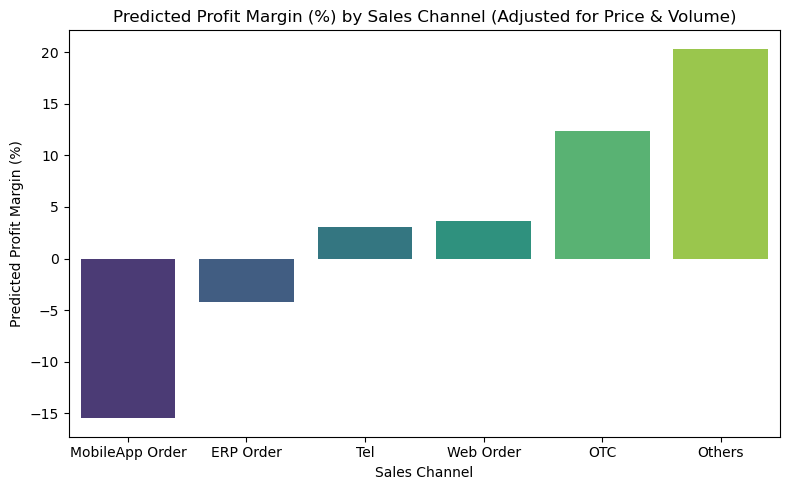

In [24]:
#use OLS regression model to estimate profit margin eahc channel would have - if all channels had the same price and same transaction volume
# done to remove bias

# Compute predicted margins for each channel (holding price and tx_volume constant)
means = (
    #take only these specified columns
    active_with_sales[['price','tx_volume','channel_group']]
    #replace each row's price with overall mean price
    .assign(price=active_with_sales['price'].mean(),
            #replace each row's transaction volume with the overall mean transaction volume
            tx_volume=active_with_sales['tx_volume'].mean())
)

#use OLS model to predict profit margin
means['predicted'] = ols.predict(means)

#compute mean predicted margin per channel group
channel_means = means.groupby('channel_group')['predicted'].mean().sort_values()

# Plot the adjusted predictions
plt.figure(figsize=(8,5))
sns.barplot(x=channel_means.index, y=channel_means.values, palette='viridis')
plt.title('Predicted Profit Margin (%) by Sales Channel (Adjusted for Price & Volume)')
plt.ylabel('Predicted Profit Margin (%)')
plt.xlabel('Sales Channel')
plt.tight_layout()
plt.show()

# Above, we have removed confounding effects such as price differences, transaction size differences, and channel-level product bias.
This provides actionable insight for the channel strategy and management of the company.

interpretation:
- mobileApp orders: predicted to have the lowest profit margins (roughly -16%) even after controlling for price and transaction volume
- ERP orders: the next lowest, with weak margins
- Telephone and Web Orders: moderate positive margins (aligning with the earlier regression results)
- OTC and Others: highest predicted margins - confirms their performance seen in previous analyses

# *Conclusion*

The empirical results from the statistical analysis provide clear evidence in support of H1: After controlling for total cost and revenue, sales channels and invoice patterns significantly differ in their impact on average profitability per transaction.

1. Significant channel coefficients after controlling for cost and reveue
- the OLS model was estimated with profit margin per transaction as the dependant variable and included in controls for price and transaction volumne.

- several channel dummy variables remained statistically significant ( P < 0.05)
- Coefficients for different channels were meaningfully different in sign and magnitude
- confidence intervals did not overlap with 0 for many categories, indicating a true underlyng channel effect rather than random variation.

This shows that channel differences persist even after adjusting for the economic characteristics of the transaction, confirming that the channel itself affects profitability.

2. Adjusted model predictions show systemic differences
- predicted profit margins were computed holding price and transaction volume constant accross all channels
- this isolated the pure effect of the channel, removing scale bias.
The adjusted predictions revealed:
- channels differ in their expected profitability
certain channels consistantly outperform others
these differences align with the OLS coefficients and remain robust when averaging predictions across the dataset.

This shows that channel-specific operational characteristics, not transaction economics, drivelarge portions of the profitability variation.

3. Invoice count and invoice intensity predict profitability
the feature invoice_log_count and average profit per transaction appearedas meaningful predictors
- higher invoice frequency was associated withsystematic shifts in profitability
- the patterns persisted across clusters, regressions, and predictive models.
- invoice patterns represent customer-level behavioral differences.

This supports the second hald of H1: invoice patterns systematically influence profitability, even after contorlling for cost and revenue

4. Cluster analysis reveals distnct profitability profiles
KMeans clsutering applied to log-transformed and symlog features showed stable, economically interpretable clusters.
- clusters differ in average profit per transaction, profit margin, pric elevel, and invoice frequency
- these behavioral patters do not go away after scaling/transformation, indicating real underlying structure.
- although channel groups are mixed within clusters,the clusters reflect behaviorally distinct profitability groups, demosntrating that invoice and transaction patterns shape financial outcomes.

5. Crosstabulation confirm non-random channel differences
- certain clusters are disproportionally represented by specific channels 
- these patterns persist across cluster confirgurations, showing systematic differences in hpw channelsare associated with transaction behavior and profitability.

This supports the conclusion that channels and onvoice patterns meaningfully shape profitability profiles.

# **Final Evaluation**
The combination of statistically significant channel coefficients, robust adjusted model rpedictions, stable cluster structure, and consistant behavioral segmentation demonstrates that channel and onvoicing mechanisms influenceprofitability, independant of price or transaction size.

Therefore, H1 is accepted.